<a href="https://colab.research.google.com/github/nnarek/csc-cuda/blob/master/exercises/solutions.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a> <a href="https://kaggle.com/kernels/welcome?src=https://github/nnarek/csc-cuda/blob/master/exercises/solutions.ipynb" target="_parent"><img src="https://kaggle.com/static/images/open-in-kaggle.svg" alt="Open in Kaggle"/></a>

In [4]:
import os
import subprocess

if not os.path.basename(os.getcwd()) == "csc-cuda":
    if not os.path.isdir("csc-cuda"):
        subprocess.run(["git", "clone", "https://github.com/nnarek/csc-cuda"])
    os.chdir("csc-cuda")

print("cwd:", os.getcwd())

cwd: /kaggle/working/csc-cuda


# Compiling

In this exercise we will compile and run a simple cuda program
[hello.cu](hello.cu). The code is complete, and does not need to be modified. In
this course we will use both
[Taito-GPU](https://research.csc.fi/taito-gpu) as well as the local
workstations. Try to compile and run the code on both platforms.

In [4]:
%%writefile exercises/compiling/hello.cu

// Note that in this model we do not check
// the error codes and status of kernel call.

#include <cstdio>
#include <cmath>

__global__ void hello()
{
  printf("Greetings from your GPU \n");
}


int main(void)
{
  int count, device;
  cudaGetDeviceCount(&count);
  cudaGetDevice(&device);
  printf("You have in total %d GPUs in your system\n", count);
  printf("GPU %d will now print a message for you:\n", device);

  hello<<<1,1>>>();
  cudaDeviceSynchronize();
  
  return 0;	
}


Overwriting exercises/compiling/hello.cu


In [3]:
!nvcc exercises/compiling/hello.cu -o test
!./test

You have in total 1 GPUs in your system
GPU 0 will now print a message for you:
Greetings from your GPU 


# First cuda program

In this exercise we will write a simple cuda program that sets the
value of an array: `A[i] = i`. Take a look at the file [set.cu](set.cu), that
includes a skeleton of the code. Here we will complete the code by
completing these steps (a TODO exists for each step):

1. Allocate memory for the device array `d_A`
2. Free memory for the device array `d_A`
3. Complete the kernel code. The kernel assigns the global thread index to each element in the vector
4. Call the kernel with two arguments, pointer to the allocated device memory and the
length of the array.
5. Copy the result vector from device memory to host memory buffer

Pay close attention to the kernel call parameters, block and grid
sizes! Can you write the kernel so that it functions even if you
launch too many threads?

In [5]:
%%writefile exercises/first-cuda-program/set.cu
// Note that in this model we do not check
// the error codes and status of kernel call.

#include <cstdio>
#include <cmath>

__global__ void set(int *A, int N)
{
    int idx = blockIdx.x * blockDim.x + threadIdx.x;
    if(idx < N)
        A[idx] = idx;
}


int main(void)
{
    const int N = 128;
    
    int *d_A;
    int *h_A;

    h_A = (int*) malloc(N * sizeof(int));
    
    cudaMalloc(&d_A,N * sizeof(int));

    set<<<1024, 128>>>(d_A,N);

    cudaMemcpy(h_A,d_A,N,cudaMemcpyDeviceToHost);

    for (int i = 0; i < N; i++)
      printf("%i ", h_A[i]);
    printf("\n");

    free(h_A);
    
    cudaFree(d_A);

    return 0;
}

Overwriting exercises/first-cuda-program/set.cu


In [5]:
!nvcc exercises/first-cuda-program/set.cu -o test
!./test

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 


# Simple profiling with nvvp (TODO try to use nvprof instead of UI of nvvp)

The point with this excersize is to give you a very quick introduction to the Nvidia visual profiler and how to look at the program using it.

1. Compile the program: 'nvcc -lineinfo main.cu' 

2. Run the visual profiler, nvvp.

3. Create a new profiling session

4. Choose the right apllication and start the profiling

Take a look at how it looks in the profiler, figure out how long it takes to transfer the data back and forth to the device and how long the kernel execution takes.

In [6]:
!cat exercises/profile-nvvp/main.cu

#include <cuda_runtime_api.h>

__global__ void copyKernel(int *src, int *dst)
{
    const int idx = blockIdx.x * blockDim.x + threadIdx.x;
    dst[idx] = src[idx];
}

int main()
{
    int *a_dev;
    int *b_dev;
    int *a = new int[128*100];
    int *b = new int[128*100];
    cudaSetDevice(0); 

    cudaMalloc(&a_dev, sizeof(int)*128*100);
    cudaMalloc(&b_dev, sizeof(int)*128*100);

    cudaMemcpy (a_dev, a, sizeof(int)*1000, cudaMemcpyHostToDevice);

    copyKernel<<<100, 128>>>(a_dev, b_dev);
    cudaDeviceSynchronize();

    cudaMemcpy (b, b_dev, sizeof(int)*1000, cudaMemcpyDeviceToHost);

}

In [7]:
!nvcc -lineinfo exercises/profile-nvvp/main.cu
!nvvp

/bin/bash: line 1: nvvp: command not found


# Simple profiling with nvprof (TODO need sudo)

The goal is to give you a chance to test out how the command line profiler works.

1. Compile program

2. run the program through nvprof

Figure out the data transfer times and run time for the kernels, do they all take the same time?

For more of a challange you can try and determine the number of floating point operations performed.

In [8]:
!cat exercises/profile-nvprof/main.cu

#include <cuda_runtime_api.h>

__global__ void scaleKernel(float *src, float *dst, float scale)
{
    const int idx = blockIdx.x * blockDim.x + threadIdx.x;
    dst[idx] = src[idx] * scale;
}

int main()
{

    float *a_dev;
    float *b_dev;
    float *a = new float[128*100];
    float *b = new float[128*100];
    cudaSetDevice(0); 

    cudaMalloc(&a_dev, sizeof(float)*128*100);
    cudaMalloc(&b_dev, sizeof(float)*128*100);

    cudaMemcpy (a_dev, a, sizeof(float)*1000, cudaMemcpyHostToDevice);

    scaleKernel<<<100, 128>>>(a_dev, b_dev, 4.0f);
    scaleKernel<<<50, 128>>>(a_dev, b_dev, 4.0f);
    scaleKernel<<<50, 128>>>(a_dev+50, b_dev+50, 4.0f);
    scaleKernel<<<100, 128>>>(a_dev, b_dev, 4.0f);
    cudaDeviceSynchronize();

    cudaMemcpy (b, b_dev, sizeof(int)*1000, cudaMemcpyDeviceToHost);
}

In [9]:
%%writefile /etc/sudoers
#
# This file MUST be edited with the 'visudo' command as root.
#
# Please consider adding local content in /etc/sudoers.d/ instead of
# directly modifying this file.
#
# See the man page for details on how to write a sudoers file.
#
#Defaults	env_reset
#Defaults	mail_badpass
#Defaults	secure_path="/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/snap/bin:/usr/local/cuda/bin/"
#Defaults	use_pty

# This preserves proxy settings from user environments of root
# equivalent users (group sudo)
#Defaults:%sudo env_keep += "http_proxy https_proxy ftp_proxy all_proxy no_proxy"

# This allows running arbitrary commands, but so does ALL, and it means
# different sudoers have their choice of editor respected.
#Defaults:%sudo env_keep += "EDITOR"

# Completely harmless preservation of a user preference.
#Defaults:%sudo env_keep += "GREP_COLOR"

# While you shouldn't normally run git as root, you need to with etckeeper
#Defaults:%sudo env_keep += "GIT_AUTHOR_* GIT_COMMITTER_*"

# Per-user preferences; root won't have sensible values for them.
#Defaults:%sudo env_keep += "EMAIL DEBEMAIL DEBFULLNAME"

# "sudo scp" or "sudo rsync" should be able to use your SSH agent.
#Defaults:%sudo env_keep += "SSH_AGENT_PID SSH_AUTH_SOCK"

# Ditto for GPG agent
#Defaults:%sudo env_keep += "GPG_AGENT_INFO"

# Host alias specification

# User alias specification

# Cmnd alias specification

# User privilege specification
root	ALL=(ALL:ALL) ALL

# Members of the admin group may gain root privileges
%admin ALL=(ALL) ALL

# Allow members of group sudo to execute any command
%sudo	ALL=(ALL:ALL) ALL

# See sudoers(5) for more information on "@include" directives:

@includedir /etc/sudoers.d


Overwriting /etc/sudoers


In [10]:
!nvcc exercises/profile-nvprof/main.cu -o test
!nvprof ./test

==234== NVPROF is profiling process 234, command: ./test
==234== Profiling application: ./test
==234== Profiling result:
            Type  Time(%)      Time     Calls       Avg       Min       Max  Name
 GPU activities:   75.88%  8.9600us         4  2.2400us  1.6640us  3.5520us  scaleKernel(float*, float*, float)
                   15.99%  1.8880us         1  1.8880us  1.8880us  1.8880us  [CUDA memcpy DtoH]
                    8.13%     960ns         1     960ns     960ns     960ns  [CUDA memcpy HtoD]
      API calls:   85.44%  85.566ms         1  85.566ms  85.566ms  85.566ms  cudaSetDevice
                   13.19%  13.205ms         4  3.3013ms  3.5610us  13.190ms  cudaLaunchKernel
                    1.02%  1.0188ms         1  1.0188ms  1.0188ms  1.0188ms  cuDeviceGetPCIBusId
                    0.17%  168.13us       114  1.4740us     135ns  77.334us  cuDeviceGetAttribute
                    0.11%  112.53us         2  56.266us  3.2940us  109.24us  cudaMalloc
                    0.06%

coping from device to host is almost 2 time slow compared with coping from host to device because int is two time big than float

In [11]:
!sudo nvprof --metrics flops_sp,flops_dp,flops_hp ./test

======== Error: internal error.


reports number of floating point operations TODO finish it https://forums.developer.nvidia.com/t/err-nvgpuctrperm-the-user-does-not-have-permission-to-profile-on-the-target-device/76285/3
* flops_hp is FP16(half precision)
* flops_sp is FP32(single precision)
* flops_dp is FP64(double precision) 

# Basic debugging using cuda-memcheck

The idea is that you should use cuda-memcheck to figure out why the program is not working. The program should copy the values from one array to another.

Compile program and figure out why it is not working.

In [12]:
!cat exercises/debug-cuda-memcheck/main.cu

#include <cuda_runtime_api.h>
#include <iostream>

__global__ void copyKernel(int *src, int *dst, int size)
{
    const int idx = blockIdx.x * blockDim.x + threadIdx.x;
    if(idx > size)
        return;
    dst[idx] = src[idx];
}

int main()
{
    int *a_dev;
    int *b_dev;
    int *a = new int[1000];
    int *b = new int[1000];
    cudaSetDevice(0); 

    cudaMalloc(&a_dev, sizeof(int)*1000);
    cudaMalloc(&b_dev, sizeof(int)*1000);

    cudaMemcpy (a_dev, a, sizeof(int)*1000, cudaMemcpyHostToDevice);

    copyKernel<<<100, 128>>>(a_dev, b_dev, 1000);

    cudaMemcpy (b, b_dev, sizeof(int)*1000, cudaMemcpyDeviceToHost);

}


In [13]:
!nvcc exercises/debug-cuda-memcheck/main.cu -o test
!./test

In [14]:
!compute-sanitizer --tool memcheck ./test

========= COMPUTE-SANITIZER
========= Invalid __global__ read of size 4 bytes
=========     at 0x90 in copyKernel(int *, int *, int)
=========     by thread (104,0,0) in block (7,0,0)
=========     Address 0x78854e800fa0 is out of bounds
=========     and is 1 bytes after the nearest allocation at 0x78854e800000 of size 4,000 bytes
=========     Saved host backtrace up to driver entry point at kernel launch time
=========     Host Frame: [0x2dcdc0]
=========                in /usr/local/nvidia/lib64/libcuda.so.1
=========     Host Frame:libcudart_static_4d8b33a106dceb3c07a56e26de61f2d53bb62a68 [0x1070e]
=========                in /kaggle/working/./test
=========     Host Frame:cudaLaunchKernel [0x7091e]
=========                in /kaggle/working/./test
=========     Host Frame:cudaError cudaLaunchKernel<char>(char const*, dim3, dim3, void**, unsigned long, CUstream_st*) [0xb021]
=========                in /kaggle/working/./test
=========     Host Frame:__device_stub__Z10copyKernelPi

warns about invalid access of VRAM. we need to check **idx >= size** to exit from function and after that all checks should pass

In [6]:
%%writefile exercises/debug-cuda-memcheck/main.cu
#include <cuda_runtime_api.h>
#include <iostream>

__global__ void copyKernel(int *src, int *dst, int size)
{
    const int idx = blockIdx.x * blockDim.x + threadIdx.x;
    if(idx >= size)
        return;
    dst[idx] = src[idx];
}

int main()
{
    int *a_dev;
    int *b_dev;
    int *a = new int[1000];
    int *b = new int[1000];
    cudaSetDevice(0); 

    cudaMalloc(&a_dev, sizeof(int)*1000);
    cudaMalloc(&b_dev, sizeof(int)*1000);

    cudaMemcpy (a_dev, a, sizeof(int)*1000, cudaMemcpyHostToDevice);

    copyKernel<<<100, 128>>>(a_dev, b_dev, 1000);

    cudaMemcpy (b, b_dev, sizeof(int)*1000, cudaMemcpyDeviceToHost);

}


Overwriting exercises/debug-cuda-memcheck/main.cu


In [16]:
!nvcc exercises/debug-cuda-memcheck/main.cu -o test
!./test

In [17]:
!compute-sanitizer --tool memcheck ./test
!compute-sanitizer --tool racecheck ./test
!compute-sanitizer --tool synccheck ./test
!compute-sanitizer --tool initcheck ./test

========= COMPUTE-SANITIZER
========= ERROR SUMMARY: 0 errors
========= COMPUTE-SANITIZER
========= RACECHECK SUMMARY: 0 hazards displayed (0 errors, 0 warnings)
========= COMPUTE-SANITIZER
========= ERROR SUMMARY: 0 errors
========= COMPUTE-SANITIZER
========= ERROR SUMMARY: 0 errors


# Debugging with nsight (TODO need UI)

The goal here is to give you a quick introduction to the nsight IDE and how it can be used to debug your cuda programs.

1. Start nsight, works a lot easier on the local machines.

2. Import the project provided using nsight.
    - File -> Import -> General -> Existing projects into workspace
    - Choose the current directory as root and import
    - ASK IF YOU HAVE ISSUES IMPORTING IT !!!

3. Run the program in debugging mode, you may need to change to the debugging mode mnaually.

Figure out what value thread 824 reads from memory, thread 56 of block 3. Or if you cannot find it look at any other thread.

Hint: use breakpoints to stop the program execution.

# Error checking

Start from the provided skeleton code [error-test.cu](error-test.cu) that
provides some convenience macros for error checking. The macros are defined
in the header file [error_checks.h](error_checks.h). Add the missing memory allocations
and copies and the kernel launch and check that your code works.

1. What happens if you try to launch kernel with too large block size? When do you
catch the error if you remove the `cudaDeviceSynchronize()` call?
2. What happens if you try to dereference a pointer to device memory in host code?
3. What if you try to access host memory from the kernel?

Remember that you can use also cuda-memcheck! If you have time, you can also
check what happens if you remove all error checks and do the same tests again.

In [7]:
%%writefile exercises/error-checking/error-test.cu
#include <cstdio>
#include <cmath>
#include "error_checks.h" // Macros CUDA_CHECK and CHECK_ERROR_MSG


__global__ void vector_add(double *C, const double *A, const double *B, int N)
{
    // Accessing host memory from kernel
    //printf("%5.1f",*B);
    
    // Add the kernel code
    int idx = blockIdx.x * blockDim.x + threadIdx.x;

    // Do not try to access past the allocated memory
    if (idx < N) {
        C[idx] = A[idx] + B[idx];
    }
}


int main(void)
{
    const int N = 20;
    const int ThreadsInBlock = 128;
    double *dA, *dB, *dC;
    double hA[N], hB[N], hC[N];
  
    for(int i = 0; i < N; ++i) {
        hA[i] = (double) i;
        hB[i] = (double) i * i;
    }

    /* 
       Add memory allocations and copies. Wrap your runtime function
       calls with CUDA_CHECK( ) macro
    */
    CUDA_CHECK( cudaMalloc((void**)&dA, sizeof(double)*N) );
    CUDA_CHECK( cudaMalloc((void**)&dB, sizeof(double)*N) );
    CUDA_CHECK( cudaMalloc((void**)&dC, sizeof(double)*N) );
    CUDA_CHECK( cudaMemcpy(dA,hA,sizeof(double)*N,cudaMemcpyHostToDevice) );
    CUDA_CHECK( cudaMemcpy(dB,hB,sizeof(double)*N,cudaMemcpyHostToDevice) );

    // Note the maximum size of threads in a block
    dim3 grid, threads; 
    grid.x = 1;
    threads.x = ThreadsInBlock;//+10241024; // Adding lot of threads

    //// Add the kernel call here
    vector_add<<<grid,threads>>>(dC,dA,dB,N);

    // Accessing host memory from kernel
    //vector_add<<<grid,threads>>>(dC,dA,hB,N);

    // Dereferening device memory pointer
    //printf("%5.1f",*dC);

    // Here we add an explicit synchronization so that we catch errors
    // as early as possible. Don't do this in production code!
    cudaDeviceSynchronize();
    CHECK_ERROR_MSG("vector_add kernel");

    //// Copy back the results and free the device memory
    CUDA_CHECK( cudaMemcpy(hC,dC,sizeof(double)*N,cudaMemcpyDeviceToHost) );
    CUDA_CHECK( cudaFree(dA) );
    CUDA_CHECK( cudaFree(dB) );
    CUDA_CHECK( cudaFree(dC) );

    for (int i = 0; i < N; i++)
        printf("%5.1f\n", hC[i]);

    return 0;
}


Overwriting exercises/error-checking/error-test.cu


In [19]:
!nvcc exercises/error-checking/error-test.cu -o test
!./test

  0.0
  2.0
  6.0
 12.0
 20.0
 30.0
 42.0
 56.0
 72.0
 90.0
110.0
132.0
156.0
182.0
210.0
240.0
272.0
306.0
342.0
380.0


1. I get `invalid configuration argument` runtime error with big number of threads and it will be reported after failed launch of kernel after `cudaDeviceSynchronize()`
2. Dereferencing pointer of device memory will lead to crash
3. I get `an illegal memory access was encountered` runtime error when try to run kernel by passing pointer of host memory

# Jacobi iteration

In this exercise we will implement a Jacobi iteration which is a very simple
finite-difference scheme. Familiarize yourself with the provided skeleton.
Then implement following things:

1. Write the missing CUDA kernel `sweepGPU` that implements the same algorithm
   as the sweepCPU function. Check that the reported averate difference is in
   the order of the numerical accuracy.
2. Experiment with different grid and block sizes and compare the execution times.
   Use the `nvvp` to check how you modifications affect the execution.

In [8]:
%%writefile exercises/jacobi/jacobi.cu
#include <sys/time.h>
#include <cstdio>
#include "jacobi.h"
#include "error_checks.h"

// Change this to 0 if CPU reference result is not needed
#define COMPUTE_CPU_REFERENCE 1
#define MAX_ITERATIONS 3000

// CPU kernel
void sweepCPU(double* phi, const double *phiPrev, const double *source, 
              double h2, int N)
{ 
    int i, j;
    int index, i1, i2, i3, i4;

    for (j = 1; j < N-1; j++) {
        for (i = 1; i < N-1; i++) {
            index = i + j*N; 
            i1 = (i-1) +   j   * N;
            i2 = (i+1) +   j   * N;
            i3 =   i   + (j-1) * N;
            i4 =   i   + (j+1) * N;
            phi[index] = 0.25 * (phiPrev[i1] + phiPrev[i2] + 
                                 phiPrev[i3] + phiPrev[i4] - 
                                 h2 * source[index]);
        } 
    }
} 

// GPU kernel
__global__ 
void sweepGPU(double *phi, const double *phiPrev, const double *source, 
              double h2, int N)
{
    int ix = blockIdx.x * blockDim.x + threadIdx.x;
    int iy = blockIdx.y * blockDim.y + threadIdx.y;
    int index = ix + iy*N;
    if(0 < ix && ix < (N-1) && 0 < iy && iy < (N-1)){
        phi[index] = 0.25 * (phiPrev[index-1] + phiPrev[index+1] + phiPrev[index+N] + phiPrev[index-N] - h2*source[index]);
    }
}


double compareArrays(const double *a, const double *b, int N)
{
    double error = 0.0;
    int i;
    for (i = 0; i < N*N; i++) {
        error += fabs(a[i] - b[i]);
    }
    return error/(N*N);
}


double diffCPU(const double *phi, const double *phiPrev, int N)
{
    int i;
    double sum = 0;
    double diffsum = 0;
    
    for (i = 0; i < N*N; i++) {
        diffsum += (phi[i] - phiPrev[i]) * (phi[i] - phiPrev[i]);
        sum += phi[i] * phi[i];
    }

    return sqrt(diffsum/sum);
}


int main() 
{ 
    timeval t1, t2; // Structs for timing
    const int N = 512;
    double h = 1.0 / (N - 1);
    int iterations;
    const double tolerance = 5e-4; // Stopping condition
    int i, j, index;

    const int blocksize = 16;
  
    double *phi      = new double[N*N]; 
    double *phiPrev  = new double[N*N]; 
    double *source   = new double[N*N]; 
    double *phi_cuda = new double[N*N]; 

    double *phi_d, *phiPrev_d, *source_d; 
    // Size of the arrays in bytes
    const int size = N*N*sizeof(double); 
    double diff;
  
    // Source initialization
    for (i = 0; i < N; i++) {
        for (j = 0; j < N; j++) {      
            double x, y;
            x = (i - N / 2) * h;
            y = (j - N / 2) * h;
            index = j + i * N;
            if (((x - 0.25) * (x - 0.25) + y * y) < 0.1 * 0.1)
                source[index] = 1e10*h*h;
            else if (((x + 0.25) * (x + 0.25) + y * y) < 0.1 * 0.1)
                source[index] = -1e10*h*h;
            else
                source[index] = 0.0;
        }            
    }

    CUDA_CHECK( cudaMalloc( (void**)&source_d, size) ); 
    CUDA_CHECK( cudaMemcpy(source_d, source, size, cudaMemcpyHostToDevice) ); 

    // Reset values to zero
    for (i = 0; i < N; i++) {
        for (j = 0; j < N; j++) {      
            index = j + i * N;
            phi[index] = 0.0; 
            phiPrev[index] = 0.0; 
        }            
    }

    CUDA_CHECK( cudaMalloc( (void**)&phi_d, size) ); 
    CUDA_CHECK( cudaMalloc( (void**)&phiPrev_d, size) ); 
    CUDA_CHECK( cudaMemcpy(phi_d, phi, size, cudaMemcpyHostToDevice) );
    CUDA_CHECK( cudaMemcpy(phiPrev_d, phiPrev, size, cudaMemcpyHostToDevice) );

    // CPU version 
    if(COMPUTE_CPU_REFERENCE) { 
        gettimeofday(&t1, NULL);

        // Do sweeps untill difference is under the tolerance
        diff = tolerance * 2;
        iterations = 0;
        while (diff > tolerance && iterations < MAX_ITERATIONS) {
            sweepCPU(phiPrev, phi, source, h * h, N);
            sweepCPU(phi, phiPrev, source, h * h, N);
            
            iterations += 2;
            if (iterations % 100 == 0) {
                diff = diffCPU(phi, phiPrev, N);
                printf("%d %g\n", iterations, diff);
            }
        }
        gettimeofday(&t2, NULL);
        printf("CPU Jacobi: %g seconds, %d iterations\n", 
               t2.tv_sec - t1.tv_sec + 
               (t2.tv_usec - t1.tv_usec) / 1.0e6, iterations);
    }

    // GPU version

    dim3 dimBlock(blocksize, blocksize); 
    dim3 dimGrid((N + blocksize - 1) / blocksize, (N + blocksize - 1) / blocksize); 
    
    //do sweeps until diff under tolerance
    diff = tolerance * 2;
    iterations = 0;

    gettimeofday(&t1, NULL);

    while (diff > tolerance && iterations < MAX_ITERATIONS) {
        // See above how the CPU update kernel is called
        // and implement similar calling sequence for the GPU code

        //// Add routines here
        sweepGPU<<<dimGrid,dimBlock>>>(phiPrev_d, phi_d, source_d, h * h, N);
        sweepGPU<<<dimGrid,dimBlock>>>(phi_d, phiPrev_d, source_d, h * h, N);

        iterations += 2;
        
        if (iterations % 100 == 0) {
            // diffGPU is defined in the header file, it uses
            // Thrust library for reduction computation
            diff = diffGPU<double>(phiPrev_d, phi_d, N);
            CHECK_ERROR_MSG("Difference computation");
            printf("%d %g\n", iterations, diff);
        }
    }
    
    //// Add here the routine to copy back the results
    CUDA_CHECK( cudaMemcpy(phi_cuda, phi_d, size, cudaMemcpyDeviceToHost) );

    gettimeofday(&t2, NULL);
    printf("GPU Jacobi: %g seconds, %d iterations\n", 
           t2.tv_sec - t1.tv_sec + 
           (t2.tv_usec - t1.tv_usec) / 1.0e6, iterations);

    //// Add here the clean up code for all allocated CUDA resources
    CUDA_CHECK( cudaFree(source_d) ); 
    CUDA_CHECK( cudaFree(phi_d) ); 
    CUDA_CHECK( cudaFree(phiPrev_d) );  

    if (COMPUTE_CPU_REFERENCE) {
        printf("Average difference is %g\n", compareArrays(phi, phi_cuda, N));
    }
    
    delete[] phi; 
    delete[] phi_cuda;
    delete[] phiPrev; 
    delete[] source; 
    
    return EXIT_SUCCESS; 
} 


Overwriting exercises/jacobi/jacobi.cu


In [38]:
!nvcc exercises/jacobi/jacobi.cu -o test
!./test

100 0.00972858
200 0.00479832
300 0.00316256
400 0.00234765
500 0.00186023
600 0.00153621
700 0.0013054
800 0.00113277
900 0.000998881
1000 0.000892078
1100 0.00080496
1200 0.000732594
1300 0.000671564
1400 0.000619434
1500 0.000574415
1600 0.000535167
1700 0.000500665
1800 0.000470113
CPU Jacobi: 3.9594 seconds, 1800 iterations
100 0.00972858
200 0.00479832
300 0.00316256
400 0.00234765
500 0.00186023
600 0.00153621
700 0.0013054
800 0.00113277
900 0.000998881
1000 0.000892078
1100 0.00080496
1200 0.000732594
1300 0.000671564
1400 0.000619434
1500 0.000574415
1600 0.000535167
1700 0.000500665
1800 0.000470113
GPU Jacobi: 0.035116 seconds, 1800 iterations
Average difference is 4.89877e-16


1. In last run, difference is mear 4.8e-16 which is very small
2. Performance decreases after reducing the number of threads

# Timing Jacobi iteration with events

In this exercise we will modify the previous Jacobi iteration exercises so that GPU timings are done using events.

In [9]:
%%writefile exercises/jacobi-timing-events/jacobi.cu
#include <sys/time.h>
#include <cstdio>
#include "jacobi.h"
#include "error_checks.h"

// Change this to 0 if CPU reference result is not needed
#define COMPUTE_CPU_REFERENCE 1
#define MAX_ITERATIONS 3000

// CPU kernel
void sweepCPU(double* phi, const double *phiPrev, const double *source, 
              double h2, int N)
{ 
    int i, j;
    int index, i1, i2, i3, i4;

    for (j = 1; j < N-1; j++) {
        for (i = 1; i < N-1; i++) {
            index = i + j*N; 
            i1 = (i-1) +   j   * N;
            i2 = (i+1) +   j   * N;
            i3 =   i   + (j-1) * N;
            i4 =   i   + (j+1) * N;
            phi[index] = 0.25 * (phiPrev[i1] + phiPrev[i2] + 
                                 phiPrev[i3] + phiPrev[i4] - 
                                 h2 * source[index]);
        } 
    }
} 

// GPU kernel
__global__ 
void sweepGPU(double *phi, const double *phiPrev, const double *source, 
              double h2, int N)
{
    int i = blockIdx.x * blockDim.x + threadIdx.x;
    int j = blockIdx.y * blockDim.y + threadIdx.y;
    int index = i + j*N;
    int i1, i2, i3, i4;

    i1 = (i-1) +   j   * N;
    i2 = (i+1) +   j   * N;
    i3 =   i   + (j-1) * N;
    i4 =   i   + (j+1) * N;

    if (i > 0 && j > 0 && i < N-1 && j < N-1)
        phi[index] = 0.25 * (phiPrev[i1] + phiPrev[i2] + 
                             phiPrev[i3] + phiPrev[i4] - 
                             h2 * source[index]);
}


double compareArrays(const double *a, const double *b, int N)
{
    double error = 0.0;
    int i;
    for (i = 0; i < N*N; i++) {
        error += fabs(a[i] - b[i]);
    }
    return error/(N*N);
}


double diffCPU(const double *phi, const double *phiPrev, int N)
{
    int i;
    double sum = 0;
    double diffsum = 0;
    
    for (i = 0; i < N*N; i++) {
        diffsum += (phi[i] - phiPrev[i]) * (phi[i] - phiPrev[i]);
        sum += phi[i] * phi[i];
    }

    return sqrt(diffsum/sum);
}


int main() 
{ 
    timeval t1, t2; // Structs for timing
    const int N = 512;
    double h = 1.0 / (N - 1);
    int iterations;
    const double tolerance = 5e-4; // Stopping condition
    int i, j, index;

    const int blocksize = 16;
  
    double *phi      = new double[N*N]; 
    double *phiPrev  = new double[N*N]; 
    double *source   = new double[N*N]; 
    double *phi_cuda = new double[N*N]; 

    double *phi_d, *phiPrev_d, *source_d; 
    // Size of the arrays in bytes
    const int size = N*N*sizeof(double); 
    double diff;
  
    // Source initialization
    for (i = 0; i < N; i++) {
        for (j = 0; j < N; j++) {      
            double x, y;
            x = (i - N / 2) * h;
            y = (j - N / 2) * h;
            index = j + i * N;
            if (((x - 0.25) * (x - 0.25) + y * y) < 0.1 * 0.1)
                source[index] = 1e10*h*h;
            else if (((x + 0.25) * (x + 0.25) + y * y) < 0.1 * 0.1)
                source[index] = -1e10*h*h;
            else
                source[index] = 0.0;
        }            
    }

    CUDA_CHECK( cudaMalloc( (void**)&source_d, size) ); 
    CUDA_CHECK( cudaMemcpy(source_d, source, size, cudaMemcpyHostToDevice) ); 

    // Reset values to zero
    for (i = 0; i < N; i++) {
        for (j = 0; j < N; j++) {      
            index = j + i * N;
            phi[index] = 0.0; 
            phiPrev[index] = 0.0; 
        }            
    }

    CUDA_CHECK( cudaMalloc( (void**)&phi_d, size) ); 
    CUDA_CHECK( cudaMalloc( (void**)&phiPrev_d, size) ); 
    CUDA_CHECK( cudaMemcpy(phi_d, phi, size, cudaMemcpyHostToDevice) );
    CUDA_CHECK( cudaMemcpy(phiPrev_d, phiPrev, size, cudaMemcpyHostToDevice) );

    // CPU version 
    if(COMPUTE_CPU_REFERENCE) { 
        gettimeofday(&t1, NULL);

        // Do sweeps untill difference is under the tolerance
        diff = tolerance * 2;
        iterations = 0;
        while (diff > tolerance && iterations < MAX_ITERATIONS) {
            sweepCPU(phiPrev, phi, source, h * h, N);
            sweepCPU(phi, phiPrev, source, h * h, N);
            
            iterations += 2;
            if (iterations % 100 == 0) {
                diff = diffCPU(phi, phiPrev, N);
                printf("%d %g\n", iterations, diff);
            }
        }
        gettimeofday(&t2, NULL);
        printf("CPU Jacobi: %g seconds, %d iterations\n", 
               t2.tv_sec - t1.tv_sec + 
               (t2.tv_usec - t1.tv_usec) / 1.0e6, iterations);
    }

    // GPU version

    //// Add the event initialization here
    cudaEvent_t start_event;
    CUDA_CHECK( cudaEventCreate(&start_event) );
    cudaEvent_t end_event;
    CUDA_CHECK( cudaEventCreate(&end_event) );


    dim3 dimBlock(blocksize, blocksize); 
    dim3 dimGrid((N + blocksize - 1) / blocksize, (N + blocksize - 1) / blocksize); 
    
    //do sweeps until diff under tolerance
    diff = tolerance * 2;
    iterations = 0;

    CUDA_CHECK( cudaEventRecord(&start_event) );

    while (diff > tolerance && iterations < MAX_ITERATIONS) {
        // See above how the CPU update kernel is called
        // and implement similar calling sequence for the GPU code

        sweepGPU<<<dimGrid, dimBlock>>>(phiPrev_d, phi_d, source_d, h*h, N); 
        sweepGPU<<<dimGrid, dimBlock>>>(phi_d, phiPrev_d, source_d, h*h, N); 
        CHECK_ERROR_MSG("Jacobi kernels");
        iterations += 2;
        
        if (iterations % 100 == 0) {
            // diffGPU is defined in the header file, it uses
            // Thrust library for reduction computation
            diff = diffGPU<double>(phiPrev_d, phi_d, N);
            CHECK_ERROR_MSG("Difference computation");
            printf("%d %g\n", iterations, diff);
        }
    }
    
    CUDA_CHECK( cudaMemcpy(phi_cuda, phi_d, size, cudaMemcpyDeviceToHost) ); 

    // Determine the time needed for CUDA code execution using
    // the events that you created
    float gputime;

    CUDA_CHECK( cudaEventRecord(&end_event) );
    CUDA_CHECK( cudaEventSynchronize(end_event) );
    CUDA_CHECK( cudaEventElapsedTime(&gputime, start_event, end_event) );



    printf("GPU Jacobi: %g seconds, %d iterations\n",  gputime / 1.0e3, iterations);

    CUDA_CHECK( cudaFree(phi_d) ); 
    CUDA_CHECK( cudaFree(phiPrev_d) );
    CUDA_CHECK( cudaFree(source_d) ); 

    //// Add here the clean up code for all allocated CUDA resources
    CUDA_CHECK( cudaEventDestroy(start_event) ); 
    CUDA_CHECK( cudaEventDestroy(end_event) ); 

    if (COMPUTE_CPU_REFERENCE) {
        printf("Average difference is %g\n", compareArrays(phi, phi_cuda, N));
    }
    
    delete[] phi; 
    delete[] phi_cuda;
    delete[] phiPrev; 
    delete[] source; 
    
    return EXIT_SUCCESS; 
} 


Overwriting exercises/jacobi-timing-events/jacobi.cu


In [46]:
!nvcc exercises/jacobi/jacobi.cu -o test && ./test

100 0.00972858
200 0.00479832
300 0.00316256
400 0.00234765
500 0.00186023
600 0.00153621
700 0.0013054
800 0.00113277
900 0.000998881
1000 0.000892078
1100 0.00080496
1200 0.000732594
1300 0.000671564
1400 0.000619434
1500 0.000574415
1600 0.000535167
1700 0.000500665
1800 0.000470113
CPU Jacobi: 3.96046 seconds, 1800 iterations
100 0.00972858
200 0.00479832
300 0.00316256
400 0.00234765
500 0.00186023
600 0.00153621
700 0.0013054
800 0.00113277
900 0.000998881
1000 0.000892078
1100 0.00080496
1200 0.000732594
1300 0.000671564
1400 0.000619434
1500 0.000574415
1600 0.000535167
1700 0.000500665
1800 0.000470113
GPU Jacobi: 0.037195 seconds, 1800 iterations
Average difference is 4.89877e-16


# Streams

In this exercise we will implement a simple copy-in, compute, copy-out test and
examine how the streams can be used to overlap copying and computing. Start
from the provided skeleton and implement following parts:

1. Implement the memory allocations so that host memory allocations are page-locked.
2. Add timing events as in previous exercises.
3. Add the missing parts to the `streamtest` function.

Check the execution profile using `nvvp`.

In [10]:
%%writefile exercises/simple-streams/streams.cu
#include <cstdio>
#include <cmath>
#include "error_checks.h" // Macros CUDA_CHECK and CHECK_ERROR_MSG

// Number of iterations in the kernel
#define ITER_MULTIPLIER 4

// Number of tests, number of streams doubles for each test. That is,
// there will be 2^N_TESTS streams in the last test
#define N_TESTS 4

// Information of stream for simple domain decomposition
struct stream {
    cudaStream_t strm;   // Stream
    int len;             // Length of the part for this stream
    int start;           // Offset to the start of the part
};

// Kernel for vector summation
__global__ void vector_add(double *C, const double *A, const double *B,
                           int N, int iterations)
{
    int idx = blockIdx.x * blockDim.x + threadIdx.x;
    int stride = blockDim.x * gridDim.x;

    // Do not try to access past the allocated memory
    for (int i = idx; i < N; i += stride) {
        C[i] = 0;
        for (int j = 0; j < ITER_MULTIPLIER * iterations; j++) {
            C[i] += A[i] + B[i];
        }
    }
}


// Routine for stream test
void streamtest(double *hC, const double *hA, const double *hB,
                double *dC, const double *dA, const double *dB,
                stream *s, int nstreams, float *gputime, int tib,
                int iterations)
{
    // Add here the needed timing event calls
    cudaEvent_t start, stop;

    CUDA_CHECK( cudaEventCreate(&start) );
    CUDA_CHECK( cudaEventCreate(&stop) );

    CUDA_CHECK( cudaEventRecord(start) );    

    for (int i = 0; i < nstreams; ++i) {
        // Add here the copy - kernel execution - copy sequence
        // for each stream
        //
        // Each stream will copy their own part of the input data
        // to the GPU starting from address &(dA[sidx]).
        // Size of the block is slen (see variables below).
        int sidx = s[i].start;
        int slen = s[i].len;
                                    
        // Add here the asynchronous memory copies
        cudaMemcpyAsync((void *)&(dA[sidx]), &(hA[sidx]), sizeof(double) * slen,cudaMemcpyHostToDevice, s[i].strm);
        cudaMemcpyAsync((void *)&(dB[sidx]), &(hB[sidx]), sizeof(double) * slen,cudaMemcpyHostToDevice, s[i].strm);

        // You can use these values for the grid and block sizes
        dim3 grid, threads;
        grid.x = (slen + tib - 1) / tib;
        threads.x = tib;
       
        // Lauch the kernel to the correct stream. See the default stream
        // version for help. Use the stream s[i].strm. The data vector
        // addresses are &(dC[sidx]), etc.
        // Add kernel launch to the stream
        vector_add<<<grid,threads,0,s[i].strm>>>(&(dC[sidx]), &(dA[sidx]), &(dB[sidx]), slen, iterations);

        // Adde the missing memory copy
        // Add the asynchronous memory copy
        cudaMemcpyAsync((void *)&(hC[sidx]), &(dC[sidx]), sizeof(double) * slen,cudaMemcpyDeviceToHost, s[i].strm);
    }    

    // Add the calls needed for execution timing and compute
    // the elapsed time to the gputime variable
    CUDA_CHECK( cudaEventRecord(stop) );
    CUDA_CHECK( cudaEventSynchronize(stop) );

    CHECK_ERROR_MSG("Stream test failed");

    CUDA_CHECK( cudaEventElapsedTime(gputime, start, stop) );

    CUDA_CHECK( cudaEventDestroy(start) );
    CUDA_CHECK( cudaEventDestroy(stop) );
}

// Routine for default stream reference
void default_stream(double *hC, const double *hA, const double *hB,
                    double *dC, const double *dA, const double *dB,
                    int N, float *gputime, int tib, int iterations)
{
    // Add here the needed timing event calls
    cudaEvent_t start, stop;

    CUDA_CHECK( cudaEventCreate(&start) );
    CUDA_CHECK( cudaEventCreate(&stop) );

    CUDA_CHECK( cudaEventRecord(start) );

    // Non-asynchronous copies
    CUDA_CHECK( cudaMemcpy((void *)dA, (void *)hA,
                            sizeof(double) * N,
                            cudaMemcpyHostToDevice) );

    CUDA_CHECK( cudaMemcpy((void *)dB, (void *)hB,
                            sizeof(double) * N,
                            cudaMemcpyHostToDevice) );

    dim3 grid, threads;
    grid.x = (N + tib - 1) / tib;
    threads.x = tib;

    vector_add<<<grid, threads>>>(dC, dA, dB, N, iterations);

    CUDA_CHECK( cudaMemcpyAsync((void *)hC, (void *)dC,
				sizeof(double) * N,
				cudaMemcpyDeviceToHost) );

    // Add the calls needed for execution timing and compute
    // the elapsed time to the gputime variable
    CUDA_CHECK( cudaEventRecord(stop) );
    CUDA_CHECK( cudaEventSynchronize(stop) );

    CHECK_ERROR_MSG("Default stream test failed");

    CUDA_CHECK( cudaEventElapsedTime(gputime, start, stop) );

    CUDA_CHECK( cudaEventDestroy(start) );
    CUDA_CHECK( cudaEventDestroy(stop) );
}

// Create the streams and compute the decomposition
void create_streams(int nstreams, int vecsize, stream **strm)
{
    *strm = new stream[nstreams];
    stream *s = *strm;
    for(int i = 0; i < nstreams; i++) {
        CUDA_CHECK( cudaStreamCreate(&s[i].strm) );
    }

    s[0].start = 0;
    s[0].len = vecsize / nstreams;
    s[0].len += vecsize % nstreams ? 1 : 0;
    for(int i = 1; i < nstreams; i++) {
        int offset = vecsize / nstreams;
        if(i < vecsize % nstreams) {
            offset++;
        }
        s[i].len = offset;
        s[i].start = s[i-1].start + offset;
    }
}

// Delete the streams
void destroy_streams(int nstreams, stream *s)
{
    for(int i = 0; i < nstreams; i++) {
        CUDA_CHECK( cudaStreamDestroy(s[i].strm) );
    }
    delete[] s;
}



int main(int argc, char *argv[])
{
    const int ThreadsInBlock = 512;
    int iterations;
    double *dA, *dB, *dC;
    double *hA, *hB, *hC;
    double ref_value;
    float gputime_ref, gputimes[N_TESTS];
    stream *s;

    cudaDeviceProp prop;

    if (argc < 2) {
        printf("Usage: %s N\nwhere N is the length of the vector.\n",
                argv[0]);
        exit(EXIT_FAILURE);
    }

    int N = atoi(argv[1]);

    // Determine the number of available multiprocessors on the device.
    // It is used for a coarse adjustment of the computation part of
    // this test.
    cudaGetDeviceProperties(&prop, 0);
    iterations = (prop.multiProcessorCount + 1) / 2;

    //Add here the host memory allocation routines (page-locked)
    CUDA_CHECK( cudaHostAlloc((void**)&hA, sizeof(double) * N, cudaHostAllocDefault ) );
    CUDA_CHECK( cudaHostAlloc((void**)&hB, sizeof(double) * N, cudaHostAllocDefault ) );
    CUDA_CHECK( cudaHostAlloc((void**)&hC, sizeof(double) * N, cudaHostAllocDefault ) );

    //to allocate non locked memory
    //hA = (double *)malloc(sizeof(double) * N);
    //hB = (double *)malloc(sizeof(double) * N);
    //hC = (double *)malloc(sizeof(double) * N);

    for(int i = 0; i < N; ++i) {
        hA[i] = 1.0;
        hB[i] = 2.0;
    }

    ref_value = 3.0 * ITER_MULTIPLIER * iterations;

    CUDA_CHECK( cudaMalloc((void**)&dA, sizeof(double) * N) );
    CUDA_CHECK( cudaMalloc((void**)&dB, sizeof(double) * N) );
    CUDA_CHECK( cudaMalloc((void**)&dC, sizeof(double) * N) );
    
    // Check the timings of default stream first
    default_stream(hC, hA, hB, dC, dA, dB, N, &gputime_ref, ThreadsInBlock,
                   iterations);

    // Here we loop over the test. On each iteration, we double the number
    // of streams.
    for(int strm = 0; strm < N_TESTS; strm++) {
        int stream_count = 1<<strm;
        create_streams(stream_count, N, &s);
        streamtest(hC, hA, hB, dC, dA, dB, s, stream_count, &gputimes[strm],
                   ThreadsInBlock, iterations);
        destroy_streams(stream_count, s);
    }

    CUDA_CHECK( cudaFree((void*)dA) );
    CUDA_CHECK( cudaFree((void*)dB) );
    CUDA_CHECK( cudaFree((void*)dC) );

    int errorsum = 0;
    for (int i = 0; i < N; i++) {
        errorsum += hC[i] - ref_value;
    }

    printf("Error sum = %i\n", errorsum);
    printf("Time elapsed for reference run: %f\n", gputime_ref / 1000.);
    for(int i = 0; i < N_TESTS; i++) {
        printf("Time elapsed for test %2i:       %f\n", 1<<i,
                gputimes[i] / 1000.);
    }

    // Add here the correct host memory freeing routines
    CUDA_CHECK( cudaFreeHost(hA) );
    CUDA_CHECK( cudaFreeHost(hB) );
    CUDA_CHECK( cudaFreeHost(hC) );

    //free(hA);
    //free(hB);
    //free(hC);
    
    return 0;
}



Overwriting exercises/simple-streams/streams.cu


In [38]:
!nvcc exercises/simple-streams/streams.cu -o test && ./test 100000000

Error sum = 0
Time elapsed for reference run: 0.301215
Time elapsed for test  1:       0.295852
Time elapsed for test  2:       0.214937
Time elapsed for test  4:       0.176580
Time elapsed for test  8:       0.157751


performance decreases by about 4 times when I use non locked memory

# Volume ray tracing TODO

The program is a specialized raytracer for fractal geometry. It builds on the principle of ray marching [1], since we can't compute the interaction of a ray with the fractal geometry there is no way to get the exact intersection point. We can however compute the distance from a given point to the closest place on the fractal geometry using the distance estimator function (DE in main.cu). Based on the distance to the geometry we know we can move all the rays that far into the scene safely, we then continue to check the distance estimation function at the new place and move forward, we do this until we are sufficiently close to the geometry.

The raytracer also computes shading for the rays that hit, a quick and dirty global illumination lighting, and finally it scales down the image to give a better image quality.

The main goal is that you are able to identify the issues in the code, the code is unnecessary split into smaller kernels all doing just a part of the computation to make it easier to locate the issues in the code. If you have time you can try to fix some of the issues in the code, however that is not required, note that some of them are a lot more complex that what you probably have time for now.

Use nvvp to identify the main issues in the code that affect the performance. Even though the majority of the time is spent on the trace kernel and realistically that is the one that needs the most optimization, look at the other kernels, most of them also have some issues.

Build the program on taito-gpu: ```nvcc -O3 --std=c++11 -arch=sm_35 -lineinfo main.cu -lpng```

Recommended practice is profile it on taito and then move the results back to your own machine and look on them there.

To make things easier there are the metrics and timeline files included here.

However if you want to test it out yourself, or test any improvements you made, you can generate the files used by:

```srun --gres=gpu:1 -pgpu --reservation=cuda_thu --time=00:15:00 --mem=12000 nvprof -f --analysis-metrics -o metrics.nvvp ./a.out ```

```srun --gres=gpu:1 -pgpu --reservation=cuda_thu --time=00:15:00 --mem=12000 nvprof -f -o timeline.nvvp ./a.out ```

Then transfer the output files back to your own machine use SCP.

Assuming you cloned the exercises into your home directory the command would be :

```scp <username>@taito-gpu.csc.fi:CUDA/exercises/kernel-optimization/timeline.nvvp . ```

```scp <username>@taito-gpu.csc.fi:CUDA/exercises/kernel-optimization/metrics.nvvp . ```

Run the command on the LOCAL machine and replace ```<username>``` with your username on taito.

To import the data into nvvp on your local machine: file -> import -> nvprof -> single process, for the timeline file put timeline.nvvp and for metrics put metrics.nvvp both should be located in the exercise folder.


[1] http://jamie-wong.com/2016/07/15/ray-marching-signed-distance-functions/

In [11]:
%%writefile exercises/kernel-optimization/main.cu
#include <iostream>
#include <png.h>
#include "util.h"
#include <limits>
#include <cuda_runtime_api.h>
#include <chrono>
#include <algorithm>

using namespace std;

__device__ __host__ float de(Vec3 pos) ;

__device__ __host__ Vec3 getNormal(Vec3 pos) 
{
	Vec3 xDir = Vec3(1,0,0);
	Vec3 yDir = Vec3(0,1,0);
	Vec3 zDir = Vec3(0,0,1);
	return Vec3::normalize(Vec3(de(pos+xDir)-de(pos-xDir),
	                            de(pos+yDir)-de(pos-yDir),
	                            de(pos+zDir)-de(pos-zDir)));
}


// distance "estimation" function 
__device__ __host__ float de(Vec3 pos) 
{
    float cutoff = 2;
    float power = 8;
	Vec3 z = pos;
	float dr = 1.0;
	float r = 0.0;
	for (int i = 0; i < 10 ; i++) 
    {
		r = Vec3::length(z);
		if (r>cutoff) break;
		
		float theta = acosf(z.z/r);
		float phi = atanf(z.y);
		dr =  powf( r, power-1.0f)*power*dr + 1.0f;
		
		float zr = powf( r,power);
		theta = theta*power;
		phi = phi*power;
		
		z = Vec3(zr) * Vec3(sinf(theta)*cosf(phi), sinf(phi)*sinf(theta), cosf(theta));
		z = z + pos;
	}
	return 0.5f*logf(r)*r/dr;
}

__global__ void zero(float *arr, int size)
{
    const int i = blockIdx.x * blockDim.x + threadIdx.x;
    if (i >= size)
        return;
    arr[i] = 0;
}
__global__ void computeUV(int height, int width, float *uvxArr, float *uvyArr)
{
    const int x = blockIdx.x * blockDim.x + threadIdx.x;
    const int y = blockIdx.y * blockDim.y + threadIdx.y;
    if(x >= width)
        return;
    if(y >= height)
        return;

    float widthFloat = width;
    float heightFloat = height;

    float uvx = (tan(3.14159265 / 4.0)) * (2.0*x - widthFloat) /  widthFloat;
    float uvy = (tan(3.14159265 / 4.0)) * ( heightFloat /  widthFloat) * (2.0*y- heightFloat) /  heightFloat;
    uvxArr[(y*width)+x] = uvx;
    uvyArr[(y*width)+x] = uvy;
}

// take a look at what operations are done in "de"
__global__ void trace(int height, int width, float *uvxArr, float *uvyArr, float *distance, Vec3 lookDirection, Vec3 camUp, Vec3 camRight, Vec3 cameraLocation)
{
    int x = blockIdx.x * blockDim.x + threadIdx.x;
    int y = blockIdx.y * blockDim.y + threadIdx.y;
    if(x >= width)
        return;
    if(y >= height)
        return;

    float uvx = uvxArr[(y*width)+x];
    float uvy = uvyArr[(y*width)+x];
	Vec3 rayDirection = Vec3::normalize(lookDirection + Vec3(uvx) * camUp + Vec3(uvy) * camRight);
    float totalDistance = 0;
    bool hit = false;;
    for(int iter= 0; iter < 128; iter++)
    {
        Vec3 p = cameraLocation + Vec3(totalDistance) * rayDirection;
        
        float currentDist = de(p);
        totalDistance += currentDist;
        if (totalDistance > 10) {
    	    totalDistance = INFINITY;
    	    break;
        }
        if (currentDist < 0.00001f) {
    	    hit = true;
    	    break;
        }
    }
    distance[(y*width)+x] = totalDistance;
}

__global__ void shade(int height, int width, float *uvxArr, float *uvyArr, float *distance,
                      Vec3 lookDirection, Vec3 camUp, Vec3 camRight, Vec3 backgroundColor, Vec3 cameraLocation,
                      float *rawR, float *rawG, float *rawB)
{
    int x = blockIdx.x * blockDim.x + threadIdx.x;
    int y = blockIdx.y * blockDim.y + threadIdx.y;
    if(x >= height)
        return;
    if(y >= width)
        return;

    float uvx = uvxArr[(x*width)+y];
    float uvy = uvyArr[(x*width)+y];
    float dist = distance[(x*width)+y];

    Vec3 ret = backgroundColor;
    if(dist != INFINITY)
    {
        dist-=0.0001f;
        Vec3 rayDirection = Vec3::normalize(lookDirection + Vec3(uvx) * camUp + Vec3(uvy) * camRight);

        Vec3 hitPoint = cameraLocation + Vec3(dist) * rayDirection;
        Vec3 normal = getNormal(hitPoint);

        float lamb = 0.6;
        float spec = 0.2;
        Vec3 objectColor = Vec3(0.8,0.2,0.8);

        Vec3 toLight = ( Vec3(2,2,1) - hitPoint);
        toLight = Vec3::normalize(toLight);

        Vec3 lambIn = Vec3(lamb) * fabsf(Vec3::dot(normal, toLight));

        Vec3 specIn = Vec3(spec) * powf(fabsf(Vec3::dot(normal, Vec3::normalize(toLight - hitPoint))), 1);
        ret = clamp(((lambIn  * clamp(objectColor)) + specIn));

    }
    rawR[(x*width)+y] = ret.x;
    rawG[(x*width)+y] = ret.y;
    rawB[(x*width)+y] = ret.z;

}


__global__ void globalIllumination(int height, int width, float *uvxArr, float *uvyArr, float *distance, 
    Vec3 lookDirection, Vec3 camUp, Vec3 camRight, Vec3 backgroundColor, Vec3 cameraLocation, 
    float *rawR, float *rawG, float *rawB)
{
    
    int x = blockIdx.x * blockDim.x + threadIdx.x;
    int y = blockIdx.y * blockDim.y + threadIdx.y;
    if(x >= width)
        return;
    if(y >= height)
        return;
    float uvx = uvxArr[(y*width)+x];
    float uvy = uvyArr[(y*width)+x];
    float dist = distance[(y*width)+x];

    if(dist != INFINITY)
    {
        float gi;
        Vec3 rayDirection = Vec3::normalize(lookDirection + Vec3(uvx) * camUp + Vec3(uvy) * camRight);
        Vec3 hitPoint = cameraLocation + Vec3(dist) * rayDirection;
        Vec3 normal = getNormal(hitPoint);
        
        float totalDistance = 0;
        for(int i = 0; i < 10; i++)
        {
            Vec3 p = hitPoint + Vec3(totalDistance) * normal;
            float currentDist = de(p);
            totalDistance += currentDist;
        }
        gi = normalize(0.001,0,totalDistance);
        if (gi > 1)
            gi = 1;
        gi = 1-gi;
        rawR[(y*width)+x] *= gi;
        rawG[(y*width)+x] *= gi;
        rawB[(y*width)+x] *= gi;

    }

}
__global__ void downsample(int height, int width, int scale, float *rawR, float *rawG, float *rawB, float *imageR, float *imageG, float *imageB)
{
    const int x = blockIdx.x * blockDim.x + threadIdx.x;
    const int y = blockIdx.y * blockDim.y + threadIdx.y;
    if(x >= width)
        return;
    if(y >= height)
        return;

    int inX = x*scale;
    int inY = y*scale;

    float outR = 0;
    float outG = 0;
    float outB = 0;
    for(int i = 0; i < scale; i++)
    {
        for(int j = 0; j < scale; j++)
        {
            outR += (rawR[((inY+i)*width*scale)+(inX+j)]);
            outG += (rawG[((inY+i)*width*scale)+(inX+j)]);
            outB += (rawB[((inY+i)*width*scale)+(inX+j)]);
        }
    }
    imageR[(y*width)+x] = outR/(float)(scale*scale);
    imageG[(y*width)+x] = outG/(float)(scale*scale);
    imageB[(y*width)+x] = outB/(float)(scale*scale);
}


int main() {
    int width = 1024;
    int height = 768;

    int scale = 2;

    int heightScale = scale*height;
    int widthScale = scale*width;

    float *rawR;
    float *rawG;
    float *rawB;
    float *uvxArr;
    float *uvyArr;
    float *imageR;
    float *imageG;
    float *imageB;
    
    float *d_imageR;
    float *d_imageG;
    float *d_imageB;
    
    
    float *distance;


    cudaMalloc(&rawR, (width*scale)*(height*scale) * sizeof(float));
    cudaMalloc(&rawG, (width*scale)*(height*scale) * sizeof(float));
    cudaMalloc(&rawB, (width*scale)*(height*scale) * sizeof(float));
    cudaMalloc(&uvxArr, (width*scale)*(height*scale) * sizeof(float));
    cudaMalloc(&uvyArr, (width*scale)*(height*scale) * sizeof(float));
    cudaMalloc(&distance, (width*scale)*(height*scale) * sizeof(float));
    
    cudaMalloc(&d_imageR, width*height * sizeof(float));
    cudaMalloc(&d_imageG, width*height * sizeof(float));
    cudaMalloc(&d_imageB, width*height * sizeof(float));

    cudaMemset(rawB, 0, (width*scale)*(height*scale));
    cudaMemset(rawG, 0, (width*scale)*(height*scale));
    cudaMemset(rawB, 0, (width*scale)*(height*scale));
    cudaMemset(uvxArr, 0, (width*scale)*(height*scale));
    cudaMemset(uvyArr, 0, (width*scale)*(height*scale));
    cudaMemset(distance, 0, (width*scale)*(height*scale));
    
    cudaMemset(d_imageR, 0, (width)*(height));
    cudaMemset(d_imageG, 0, (width)*(height));
    cudaMemset(d_imageB, 0, (width)*(height));


    cudaMallocHost(&imageR, width*height * sizeof(float));
    cudaMallocHost(&imageG, width*height * sizeof(float));
    cudaMallocHost(&imageB, width*height * sizeof(float));
    

    float max = 0;
    float min = 0;

    for (int y = 0; y < height; ++y) {
        for (int x = 0; x < width; ++x) {
            imageR[((y)*width)+(x)] = 0;
            imageG[((y)*width)+(x)] = 0;
            imageB[((y)*width)+(x)] = 0;
        }
    }

    Vec3 cameraLocation = {1.2f,1.2f,1.2f};
    Vec3 focus = {0,0,0};
    Vec3 worldUp = Vec3(0,1,0);
    Vec3 lookDirection = Vec3::normalize(focus - cameraLocation);
    Vec3 camUp = Vec3::normalize(Vec3::cross(worldUp, lookDirection));
    Vec3 camRight = Vec3::normalize(Vec3::cross(lookDirection, camUp));


    // compute UV 

    dim3 threadsUv;
    dim3 blocksUv;

    threadsUv.x = 32;
    threadsUv.y = 32;

    blocksUv.x = 1+ (widthScale/threadsUv.x);
    blocksUv.y = 1+ (heightScale/threadsUv.y);

    getErrorCuda((computeUV<<<blocksUv, threadsUv>>>(heightScale, widthScale, uvxArr, uvyArr)));

    // trace

    dim3 threadsTrace;
    dim3 blocksTrace;

    threadsTrace.x = 1024;
    threadsTrace.y = 1;

    blocksTrace.x = 1 + (widthScale/threadsTrace.x);
    blocksTrace.y = 1 + (heightScale/threadsTrace.y);

    getErrorCuda((trace<<<blocksTrace, threadsTrace>>>(heightScale, widthScale, uvxArr, uvyArr, distance, lookDirection, camUp, camRight, cameraLocation)));

    Vec3 backgroundColor = {0.3f};


    // shade
    dim3 threadsShade;
    dim3 blocksShade;

    threadsShade.x = 32;
    threadsShade.y = 32;

    blocksShade.x = 1 + (heightScale/threadsShade.x);
    blocksShade.y = 1 + (widthScale/threadsShade.y);

    getErrorCuda((shade<<<blocksShade, threadsShade>>>(heightScale, widthScale, uvxArr, uvyArr, distance,
    lookDirection, camUp, camRight, backgroundColor, cameraLocation, rawR, rawG, rawB)));

    
    // global illumination

    dim3 threadsGi;
    dim3 blocksGi;

    threadsGi.x = 32;
    threadsGi.y = 32;

    blocksGi.x = 1+ (widthScale/threadsGi.x);
    blocksGi.y = 1+ (heightScale/threadsGi.y);

    getErrorCuda((globalIllumination<<<blocksGi, threadsGi>>>(heightScale, widthScale, uvxArr, uvyArr, distance, 
    lookDirection, camUp, camRight, backgroundColor, cameraLocation, rawR, rawG, rawB)));


    // downsample

    dim3 threadsDs;
    dim3 blocksDs;

    threadsDs.x = 16;
    threadsDs.y = 16;

    blocksDs.x = 1+ (width/threadsDs.x);
    blocksDs.y = 1+ (height/threadsDs.y);
    getErrorCuda((downsample<<<blocksDs, threadsDs>>>(height, width, scale, rawR, rawG, rawB, d_imageR, d_imageG, d_imageB)));

    cudaDeviceSynchronize();

    cudaMemcpy(imageR, d_imageR, sizeof(float)*height*width, cudaMemcpyDefault);
    cudaMemcpy(imageG, d_imageG, sizeof(float)*height*width, cudaMemcpyDefault);
    cudaMemcpy(imageB, d_imageB, sizeof(float)*height*width, cudaMemcpyDefault);

    std::cout << "writing image" << std::endl;
    writeImageRGB("test.png", width,height, imageR,imageG,imageB, "output");

    return 0;
}

Overwriting exercises/kernel-optimization/main.cu


In [51]:
!nvcc -O3 --std=c++11 -arch=sm_60 -lineinfo exercises/kernel-optimization/main.cu -lpng -o test && ./test

csc-cuda/exercises/kernel-optimization/util.h(44): warning #20012-D: __device__ annotation is ignored on a function("Vec3") that is explicitly defaulted on its first declaration
      __attribute__((device)) __attribute__((host)) Vec3() = default;
                     ^

Remark: The warnings can be suppressed with "-diag-suppress <warning-number>"

csc-cuda/exercises/kernel-optimization/util.h(44): warning #20012-D: __host__ annotation is ignored on a function("Vec3") that is explicitly defaulted on its first declaration
      __attribute__((device)) __attribute__((host)) Vec3() = default;
                                             ^

csc-cuda/exercises/kernel-optimization/main.cu(373): warning #2464-D: conversion from a string literal to "char *" is deprecated
      writeImageRGB("test.png", width,height, imageR,imageG,imageB, "output");
                    ^

csc-cuda/exercises/kernel-optimization/main.cu(373): warning #2464-D: conversion from a string literal to "char *" is deprec

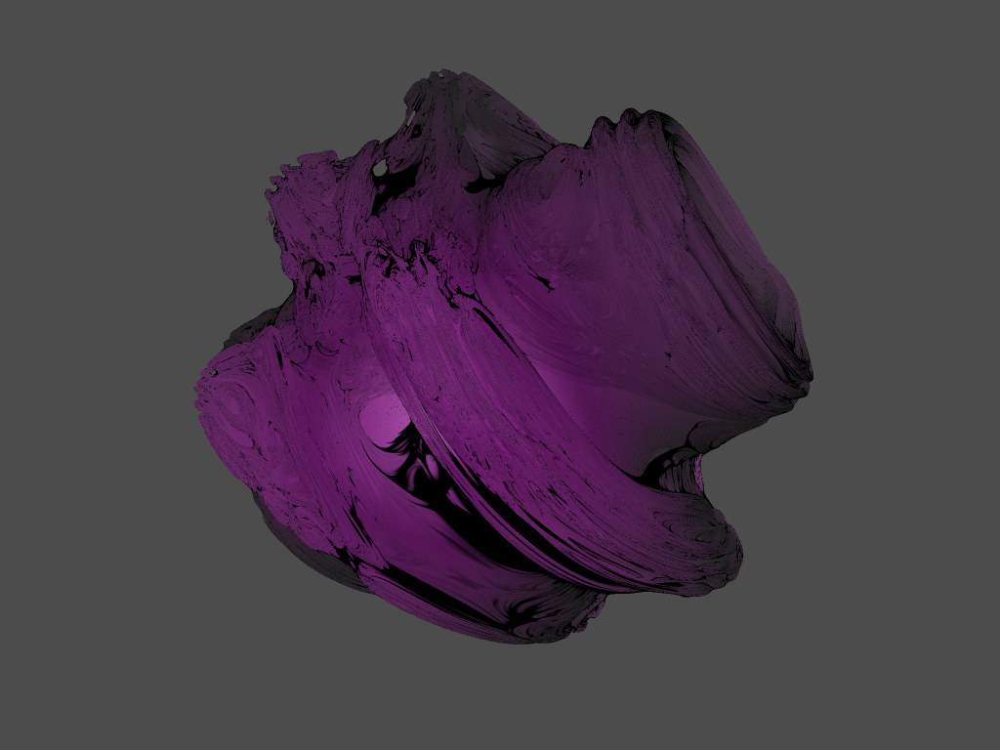

In [50]:
from IPython.display import Image
Image(filename='test.png') 

# First cuda program using unified memory

In this exercise we will take a simple program [set.cu](set.cu) that uses
device and host memory, and port it to use unified memory. The program sets
the value of an array on the device, `A[i] = i`, and transfers the data to the
host that prints out its values. 

Pay close attention to how and when you access the unified memory on the host
and device. 

In [12]:
%%writefile exercises/first-unified-memory-program/set.cu
// Note that in this model we do not check
// the error codes and status of kernel call.

#include <cstdio>
#include <cmath>

__global__ void set(int *A, int N)
{
  int idx = blockIdx.x * blockDim.x + threadIdx.x;
  if (idx < N)
    A[idx] = idx;
}


int main(void)
{
    const int N = 128;
    
    int *u_A;

    cudaError_t errarg = cudaMallocManaged((void**)&u_A, N * sizeof(int));
    if(errarg) {
        fprintf(stderr, "Error during allocation of unified memory\n");
        exit(EXIT_FAILURE);
    }

    set<<<2, 64>>>(u_A, N);

    cudaDeviceSynchronize();

    for (int i = 0; i < N; i++)
      printf("%i ", u_A[i]);
    printf("\n");
    
    cudaFree((void*)u_A);
    return 0;
}


Overwriting exercises/first-unified-memory-program/set.cu


In [16]:
!nvcc exercises/first-unified-memory-program/set.cu -o test && ./test

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 


# Unified memory with streams


In this exercise we will execute a simple kernel on the GPU that adds up two
arrays. Here we will use multiple streams to do the addition, and will
practice how to separate up managed memory allocation to different
streams. Look at the code in [streams.cu](streams.cu) and complete the TODO's

In [13]:
%%writefile exercises/unified-memory-streams/streams.cu
#include <cstdio>
#include <cmath>
#include "error_checks.h" // Macros CUDA_CHECK and CHECK_ERROR_MSG

// Number of iterations in the kernel
#define ITER_MULTIPLIER 4

// Information of stream for simple domain decomposition
struct stream {
    cudaStream_t strm;   // Stream
    int len;             // Length of the part for this stream
    double *A, *B, *C;
};

// Kernel for vector summation
__global__ void vector_add(double *C, const double *A, const double *B,
                           int N, int iterations){
    int idx = blockIdx.x * blockDim.x + threadIdx.x;
    int stride = blockDim.x * gridDim.x;

    // Do not try to access past the allocated memory
    for (int i = idx; i < N; i += stride) {
        C[i] = 0;
        for (int j = 0; j < ITER_MULTIPLIER * iterations; j++) {
            C[i] += A[i] + B[i];
        }
    }
}


// Routine for stream test
void streamtest(stream *s, int nstreams,  int tib,
                int iterations)
{

    for (int i = 0; i < nstreams; ++i) {
        // Add here the copy - kernel execution - copy sequence
        // for each stream
        int slen = s[i].len;

        dim3 grid, threads;
        grid.x = (slen + tib - 1) / tib;
        threads.x = tib;
        
        //set value on CPU
        for(int j = 0; j < s[i].len; ++j) {
           s[i].A[j] = 1.0;
           s[i].B[j] = 2.0;
        }

        vector_add<<<grid, threads, 0, s[i].strm>>>(s[i].C, s[i].A, s[i].B, slen, iterations);
    }    

    for (int i = 0; i < nstreams; ++i) {
       //check value
        double errorsum = 0;
        const double ref_value = 3.0 * ITER_MULTIPLIER * iterations;

        // Here the CPU accesses C array, make sure it is allowed to. 
        CUDA_CHECK( cudaStreamSynchronize(s[i].strm) );

        for(int j = 0; j < s[i].len; ++j) {
            errorsum += s[i].C[j] - ref_value;              
        }
        printf("Errorsum is %g on stream %d\n", errorsum, i);
    }
}

// Create the streams and compute the decomposition
void create_streams(int nstreams, int vecsize, stream **strm)
{
    *strm = new stream[nstreams];
    stream *s = *strm;
    for(int i = 0; i < nstreams; i++) {
        CUDA_CHECK( cudaStreamCreate(&s[i].strm) );
    }

    s[0].len = vecsize / nstreams;
    s[0].len += vecsize % nstreams ? 1 : 0;
    

    for(int i = 1; i < nstreams; i++) {
       int add = vecsize / nstreams;
       if(i < vecsize % nstreams) {
          add++;
       }
       s[i].len = add;
    }
    
    for(int i = 0; i < nstreams; i++) {
        // Add here allocations for managed memory    
        CUDA_CHECK( cudaMallocManaged((void**)&(s[i].A), s[i].len * sizeof(double)) );
        CUDA_CHECK( cudaMallocManaged((void**)&(s[i].B), s[i].len * sizeof(double)) );
        CUDA_CHECK( cudaMallocManaged((void**)&(s[i].C), s[i].len * sizeof(double)) );

        // Attach them to streams to enable independent operation of the various streams
        // Now each memory chunk can be accessed only from given streams
        CUDA_CHECK( cudaStreamAttachMemAsync(s[i].strm,s[i].A) );
        CUDA_CHECK( cudaStreamAttachMemAsync(s[i].strm,s[i].B) );
        CUDA_CHECK( cudaStreamAttachMemAsync(s[i].strm,s[i].C) );

    }
    
}

// Delete the streams
void destroy_streams(int nstreams, stream *s)
{
    for(int i = 0; i < nstreams; i++) {
        CUDA_CHECK( cudaStreamDestroy(s[i].strm) );
        // Free memory allocations
        cudaFree((void*)s[i].A);
        cudaFree((void*)s[i].B);
        cudaFree((void*)s[i].C);

    }
    delete[] s;
}



int main(int argc, char *argv[])
{
    const int ThreadsInBlock = 512;
    int iterations;
    stream *s;

    cudaDeviceProp prop;

    if (argc < 2) {
        printf("Usage: %s N\nwhere N is the length of the vector.\n",
                argv[0]);
        exit(EXIT_FAILURE);
    }

    int N = atoi(argv[1]);

    // Determine the number of available multiprocessors on the device.
    // It is used for a coarse adjustment of the computation part of
    // this test.
    cudaGetDeviceProperties(&prop, 0);
    iterations = (prop.multiProcessorCount + 1) / 2;


    // Now do the addition with streams, note that each stream will need to allocate its
    // own memory area 
    int stream_count = 8;
    create_streams(stream_count, N, &s);
    streamtest(s, stream_count,  ThreadsInBlock, iterations);
    destroy_streams(stream_count, s);


    return 0;
}



Overwriting exercises/unified-memory-streams/streams.cu


In [15]:
!nvcc exercises/unified-memory-streams/streams.cu -o test && nvprof ./test 6400000

==465== NVPROF is profiling process 465, command: ./test 6400000
Errorsum is 0 on stream 0
Errorsum is 0 on stream 1
Errorsum is 0 on stream 2
Errorsum is 0 on stream 3
Errorsum is 0 on stream 4
Errorsum is 0 on stream 5
Errorsum is 0 on stream 6
Errorsum is 0 on stream 7
==465== Profiling application: ./test 6400000
==465== Profiling result:
            Type  Time(%)      Time     Calls       Avg       Min       Max  Name
 GPU activities:  100.00%  26.692ms         8  3.3365ms  3.3359ms  3.3371ms  vector_add(double*, double const *, double const *, int, int)
      API calls:   68.87%  104.96ms         8  13.120ms  2.6870us  104.78ms  cudaStreamCreate
                   13.94%  21.247ms        24  885.29us  17.149us  20.653ms  cudaMallocManaged
                    9.03%  13.756ms         8  1.7195ms  1.5418ms  1.9275ms  cudaLaunchKernel
                    7.37%  11.229ms        24  467.86us  339.13us  709.92us  cudaFree
                    0.30%  459.76us       228  2.0160us     140ns

when I comment out `cudaStreamAttachMemAsync` then time which we spent on memory transfer become ~40% higher and `vector_add` become 2.5 time slow

# Dynamic parallelism and synchronization

Compile and run the provided skeleton code. Do you get numbers from
0 to 96 as output? Why the code does not work? Fix the problem!

In [14]:
%%writefile exercises/dynamic-sync/simple.cu
#include <cstdio>
#include <cassert>

const int blocksize = 96;

// kernel prototypes
__global__ void k1(void);
__global__ void k2(void);
__global__ void k3(void);

// array of values to fill
__device__ int data[blocksize];

// kernel that fills the array in device memory
__global__ void k2(void)
{
    int idx = threadIdx.x;
    if (idx < blocksize) {
        data[idx] = idx;
    }
}

// kernel that calls the fill kernel
__global__ void k1(void)
{
    int idx = threadIdx.x;

    if (idx == 0) {
        k2<<<1, blocksize>>>();
    }
}

// kernel that prints values
__global__ void k3(void)
{
    int idx = threadIdx.x;
    printf("Thread %i has value %i\n", idx, data[idx]);
}

int main(void)
{
    k1<<<1, blocksize>>>();
    cudaDeviceSynchronize();
    k3<<<1, blocksize>>>();
    cudaDeviceSynchronize();
    return 0;
}


Overwriting exercises/dynamic-sync/simple.cu


In [46]:
!nvcc exercises/dynamic-sync/simple.cu -o test -rdc=true && ./test 

Thread 32 has value 32
Thread 33 has value 33
Thread 34 has value 34
Thread 35 has value 35
Thread 36 has value 36
Thread 37 has value 37
Thread 38 has value 38
Thread 39 has value 39
Thread 40 has value 40
Thread 41 has value 41
Thread 42 has value 42
Thread 43 has value 43
Thread 44 has value 44
Thread 45 has value 45
Thread 46 has value 46
Thread 47 has value 47
Thread 48 has value 48
Thread 49 has value 49
Thread 50 has value 50
Thread 51 has value 51
Thread 52 has value 52
Thread 53 has value 53
Thread 54 has value 54
Thread 55 has value 55
Thread 56 has value 56
Thread 57 has value 57
Thread 58 has value 58
Thread 59 has value 59
Thread 60 has value 60
Thread 61 has value 61
Thread 62 has value 62
Thread 63 has value 63
Thread 64 has value 64
Thread 65 has value 65
Thread 66 has value 66
Thread 67 has value 67
Thread 68 has value 68
Thread 69 has value 69
Thread 70 has value 70
Thread 71 has value 71
Thread 72 has value 72
Thread 73 has value 73
Thread 74 has value 74
Thread 75 h

in new architectures calling `cudaDeviceSynchronize()` inside kernel is not allowed, so I refactored code

# Mandelbrot set TODO

In this exercise we take a look at Mandelbrot's set. The example code
implements the recursive Mariani-Silver algorithm (see this blog post
for detailed description of the algorithm: [https://devblogs.nvidia.com/parallelforall/introduction-cuda-dynamic-parallelism/](https://devblogs.nvidia.com/parallelforall/introduction-cuda-dynamic-parallelism/))

The provided code example can be compiled using `make` command. Run and profile the
code. Note that you can skip the output writing if you compile the code with `make WRITE_PNG=no`.

If the X11 connection seems too slow, you can save the timeline profiling results in Taito using command
```
srun -pgpu --gres=gpu:1 --mem=5G -n1 --reservation=cuda_fri nvprof -f -o timeline.nvvp ./mandelbrot
```
and then copy the result file `timeline.nvvp` back to your local workstation. See the optimization exercises
for instruction on importing the results to `nvvp`.

Try different values for maximum recursion depth (`MAX_DEPTH`) and initial
number of subdivisions (`INIT_SUBDIV`). Based on the profiling results, can you
explain why deeper recursion depth and/or larger number of initial subdivision
give faster results?

Hint: take a look at the cumulative time spent on different kernels.

In [53]:
!cd exercises/dynamic-mandelbrot && CUDA_ARCH="sm_75"  make

nvcc --x=c -arch=sm_35 -O2 -c -o pngwriter.o pngwriter.c
nvcc fatal   : Value 'sm_35' is not defined for option 'gpu-architecture'
make: *** [Makefile:11: pngwriter.o] Error 1


In [15]:
%%writefile exercises/dynamic-mandelbrot/Makefile

WRITE_PNG=yes

ifeq ($(WRITE_PNG),no)
	DFLAGS=-DSKIP_PNG_WRITING
endif

all: mandelbrot

#removed -arch=sm_35
pngwriter.o: pngwriter.c pngwriter.h
	nvcc --x=c -O2 -c -o $@ $<

#removed -arch=sm_35
mandelbrot: mandelbrot.cu pngwriter.o
	nvcc -O3 $(DFLAGS) --relocatable-device-code=true \
		-Xcompiler -Wall -Xcompiler -fopenmp $^ -o $@ -lpng

clean:
	rm -f *.o mandelbrot mandelbrot.png


Overwriting exercises/dynamic-mandelbrot/Makefile


In [67]:
!cd exercises/dynamic-mandelbrot && make && ./mandelbrot

make: Nothing to be done for 'all'.
Mandelbrot set computed in 0.255 s, at 1052.113 Mpix/s
Copying took 0.991 s


In [69]:
from IPython.display import Image
Image(filename='exercises/dynamic-mandelbrot/mandelbrot.png') 

# Multi GPU vector add

The idea is that you should modify the code so that the add kernel will be split and run on two or more devices.

You need to enumerate the devices on the current node first, allocate memory on them, move parts of the memory to each, start the kernels on all of them, and finally move the data back.

Make sure that each kernel only accesses its own memory space.

You can verify that the kernels run on both GPUs the same time using the visual profiler.

To get more gpus for your runs on taito you need to increase the number of GPUs you allocate for your job by increasing the number in the gres parameter: `--gres=gpu:1` for one GPU,  `--gres=gpu:2` for two GPUs and so on.

In [16]:
%%writefile exercises/multi-GPU/main.cu
#include <cstdio>
#include <cmath>
#include "error_checks.h" // Macros CUDA_CHECK and CHECK_ERROR_MSG


/* Information of the decomposition */
struct Decomp {
    int len; // the lenght of the array for the current device
    int start; // the start index for the array on the current device
};


/* Kernel for vector summation */
__global__ void vector_add(double *C, const double *A, const double *B, int N)
{
    int idx = blockIdx.x * blockDim.x + threadIdx.x;

    // Do not try to access past the allocated memory
    if (idx < N) {
        C[idx] = A[idx] + B[idx];
    }
}


int main(int argc, char *argv[])
{
    const int ThreadsInBlock = 128;
    double *dA[2], *dB[2], *dC[2];
    double *hA, *hB, *hC;
    int devicecount;
    cudaEvent_t start, stop;
    cudaStream_t strm[2];
    Decomp dec[2];

    CUDA_CHECK( cudaGetDeviceCount(&devicecount) );  
    if(devicecount < 2){
        printf("There is only %d devices available. for this test 2 or more is required", devicecount);
        exit(EXIT_FAILURE);
    }

    if (argc < 2) {
        printf("Usage: %s N\nwhere N is the length of the vector.\n", argv[0]);
        exit(EXIT_FAILURE);
    }

    int N = atoi(argv[1]);

    // Select device 0 and create timing events and allocate pinned host memory
    CUDA_CHECK( cudaSetDevice(0) );
    
    CUDA_CHECK( cudaEventCreate(&start) );
    CUDA_CHECK( cudaEventCreate(&stop) );

    CUDA_CHECK( cudaHostAlloc((void**)(&hA),N*sizeof(double), cudaHostAllocPortable) );//TODO check is it works without cudaHostAllocPortable flag
    CUDA_CHECK( cudaHostAlloc((void**)(&hB),N*sizeof(double), cudaHostAllocPortable) );
    CUDA_CHECK( cudaHostAlloc((void**)(&hC),N*sizeof(double), cudaHostAllocPortable) );


    // Here we initialize the host memory values    
    for(int i = 0; i < N; ++i) {
        hA[i] = 1.0;
        hB[i] = 2.0;
    }

    /* The decomposition */
    dec[0].len   = N / 2;
    dec[0].start = 0;
    dec[1].len   = N - N / 2;
    dec[1].start = dec[0].len;

    /* Allocate memory for the devices and per device streams */
    for (int i = 0; i < 2; ++i) {
        // Allocate memory areas and streams for each device
        CUDA_CHECK( cudaSetDevice(i) );
        CUDA_CHECK( cudaMalloc((void**)(dA+i),dec[i].len*sizeof(double)) );
        CUDA_CHECK( cudaMalloc((void**)(dB+i),dec[i].len*sizeof(double)) );
        CUDA_CHECK( cudaMalloc((void**)(dC+i),dec[i].len*sizeof(double)) );

        CUDA_CHECK( cudaStreamCreate(strm+i) );
    }

    /* Start timer */
    CUDA_CHECK( cudaSetDevice(0) );
    CUDA_CHECK( cudaEventRecord(start) );

    /* Copy the parts of the vectors on host to the devices and
       execute a kernel for each part. Note that we use asynchronous
       copies and streams. Without this the execution is serialized
       because the memory copies block the host process execution. */
    for (int i = 0; i < 2; ++i) {
        // Start by selecting the active device!
        // Add here the memcpy-kernel-memcpy parts
        CUDA_CHECK( cudaSetDevice(i) );
        CUDA_CHECK( cudaMemcpyAsync((void*)(dA[i]),hA+dec[i].start,dec[i].len*sizeof(double),cudaMemcpyHostToDevice,strm[i]) );
        CUDA_CHECK( cudaMemcpyAsync((void*)(dB[i]),hB+dec[i].start,dec[i].len*sizeof(double),cudaMemcpyHostToDevice,strm[i]) );

        vector_add<<<(dec[i].len)/ThreadsInBlock+1,ThreadsInBlock,0,strm[i]>>>(dC[i], dA[i], dB[i], dec[i].len);

        CUDA_CHECK( cudaMemcpyAsync((void*)(hC+dec[i].start),dC[i],dec[i].len*sizeof(double),cudaMemcpyDeviceToHost,strm[i]) );
    }

    //first time I have added record here, but it does not works because this default stream of device 0 differs from strm streams 
    //and this default stream empty and will always show near 0 elapsed time
    //CUDA_CHECK( cudaSetDevice(0) );
    //CUDA_CHECK( cudaEventRecord(stop) ); 

    //// Add here the stream synchronization calls. After both
    // streams have finished, we know that we stop the timing.
    for (int i = 0; i < 2; ++i) {
        // Add here the synchronization calls
        CUDA_CHECK( cudaSetDevice(i) );
        CUDA_CHECK( cudaStreamSynchronize(strm[i]) );
    }

    // Add here the timing event calls
    // Add here timing calls
    CUDA_CHECK( cudaSetDevice(0) );
    CUDA_CHECK( cudaEventRecord(stop) );

    /* Release device memories */
    for (int i = 0; i < 2; ++i) {
        // Add here the cleanup code
        CUDA_CHECK( cudaSetDevice(i) );
        CUDA_CHECK( cudaFree(*(dA+i)) );
        CUDA_CHECK( cudaFree(*(dB+i)) );
        CUDA_CHECK( cudaFree(*(dC+i)) );

        CUDA_CHECK( cudaStreamDestroy(strm[i]) );
    }

    int errorsum = 0;

    for (int i = 0; i < N; i++) {
        errorsum += hC[i] - 3.0;
    }

    printf("Error sum = %i\n", errorsum);

    // Compute the elapsed time and release host memory
    float gputime;
    CUDA_CHECK( cudaSetDevice(0) );
    CUDA_CHECK( cudaEventElapsedTime(&gputime, start, stop) );
    printf("Time elapsed: %f\n", gputime / 1000.);

    CUDA_CHECK( cudaFreeHost((void*)hA) );
    CUDA_CHECK( cudaFreeHost((void*)hB) );
    CUDA_CHECK( cudaFreeHost((void*)hC) );

    CUDA_CHECK( cudaEventDestroy(start) );
    CUDA_CHECK( cudaEventDestroy(stop) );
 

    return 0;
}

Overwriting exercises/multi-GPU/main.cu


In [86]:
!nvcc exercises/multi-GPU/main.cu -o test && nvprof --print-gpu-trace ./test 6400000 

==1550== NVPROF is profiling process 1550, command: ./test 6400000
Error sum = 0
Time elapsed: 0.010908
==1550== Profiling application: ./test 6400000
==1550== Profiling result:
   Start  Duration            Grid Size      Block Size     Regs*    SSMem*    DSMem*      Size  Throughput  SrcMemType  DstMemType           Device   Context    Stream  Name
502.94ms  2.1738ms                    -               -         -         -         -  24.414MB  10.968GB/s      Pinned      Device     Tesla T4 (0)         1        14  [CUDA memcpy HtoD]
505.12ms  2.1272ms                    -               -         -         -         -  24.414MB  11.208GB/s      Pinned      Device     Tesla T4 (0)         1        14  [CUDA memcpy HtoD]
507.31ms  287.03us          (25001 1 1)       (128 1 1)        16        0B        0B         -           -           -           -     Tesla T4 (0)         1        14  vector_add(double*, double const *, double const *, int) [267]
507.33ms  2.0947ms                  

# MPI ping pong TODO

The first task is to make sure that each rank selects its own GPU device in
[pingpong.cpp](pingpong.cpp).

Rank 0 sends an array filled with `1` to rank 1, which adds `1` the the values
and sends the data back. The code already implements a CPU version. Complete
also the GPU version using CUDA aware MPI.

Bonus assignment: Implement a manual version that is not using cuda aware MPI.
